In [1]:
import os
import fiona
import folium
import numpy as np
import pprint
import geopandas
import os
import folium
import geopandas
import json
from matplotlib import pyplot
from descartes import PolygonPatch
import random

In [2]:
path=r"C:\Users\JaSzw\OneDrive\Pulpit\Geoinfa\PL.PZGiK.201.32\PL.PZGiK.201.32\BDOO" 
file="PL.PZGiK.201.32__OT_ADJA_A.xml"
powiaty=os.path.join(path,file)
plik=fiona.open(powiaty)

In [3]:
pprint.pprint(plik.schema)

{'geometry': 'Polygon',
 'properties': OrderedDict([('gml_id', 'str'),
                            ('lokalnyId', 'str:32'),
                            ('przestrzenNazw', 'str:17'),
                            ('wersjaId', 'str:19'),
                            ('czyObiektBDOO', 'int:1'),
                            ('x_kod', 'str:6'),
                            ('x_skrKarto', 'str'),
                            ('x_katDoklGeom', 'str:3'),
                            ('x_zrodloDanychG', 'str:3'),
                            ('x_zrodloDanychA', 'str:3'),
                            ('x_katIstnienia', 'str'),
                            ('x_rodzajReprGeom', 'str:2'),
                            ('x_aktualnoscG', 'str:10'),
                            ('x_aktualnoscA', 'str:10'),
                            ('poczatekWersjiObiektu', 'str:19'),
                            ('x_dataUtworzenia', 'str:10'),
                            ('x_kodKarto10k', 'str'),
                            ('x_

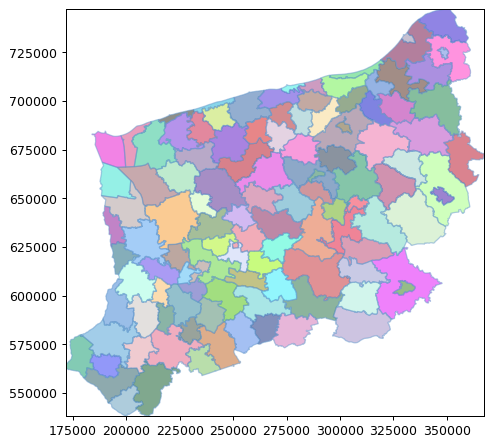

In [4]:
BLUE = '#6699cc'
RED = '#FF5733'
fig = pyplot.figure(1, figsize=(6, 6), dpi=90)
ax = fig.add_subplot(111)

with fiona.Env():

    with fiona.open(powiaty, 'r') as input:
        for f in input:
         if(f['properties']['rodzaj'] =='GM' or f['properties']['rodzaj'] =='Gmw' or f['properties']['rodzaj'] =='GW' ):
        
                                                                        ax.add_patch(
                                                                               PolygonPatch(
                                                                                   f['geometry'], fc= "#%06x" % random.randint(0, 0xFFFFFF), ec=BLUE, alpha=0.5, zorder=2 ))

a=np.array(plik.bounds)
ax.set_xlim(a[0], a[2])
ax.set_ylim(a[1], a[3])

fig.savefig('dzielnice.png')

In [5]:
import geopandas as gpd
from folium import plugins
import pandas as pd
gdf = geopandas.read_file(powiaty)
print(gdf.head())

filtr=['GM','GW', 'Gmw']
essa=gdf[gdf.rodzaj.isin(filtr)]

m = folium.Map(
    location=[53.4327,14.5483],
    tiles='OpenStreetMap',
    zoom_start=11,
    control_scale=True
    )

dane=essa[['idTerytTerc','idTerytJednostkiNadrzednej']]
folium.GeoJson(
    essa,
    style_function=lambda essa :{'fillColor': "#%06x" % random.randint(0, 0xFFFFFF)},
    ).add_to(m)

  
folium.LayerControl().add_to(m)
folium.Popup('outline Popup on GeoJSON').add_to(m)
plugins.MiniMap().add_to(m)
m.save(os.path.join(path,'dzielnice.html'))
m

                                       gml_id  \
0  ADJAA_d7decff8-c7f3-47e6-adcd-dfac5163bd67   
1  ADJAA_b5c49ff2-8b8b-4d5d-99f8-b1d8d26a9267   
2  ADJAA_09463915-613a-4cd7-8104-09380116d7e1   
3  ADJAA_861dc3ed-ec7e-48ae-9227-67c9090cae96   
4  ADJAA_84c82a15-1172-4f58-837f-310e3701f5f7   

                          lokalnyId     przestrzenNazw             wersjaId  \
0  3AE39BC5976B259FE053CC2BA8C0F2C1  PL.PZGiK.201.BDOO  2015-09-14T00:00:00   
1  3AE39BC5976C259FE053CC2BA8C0F2C1  PL.PZGiK.201.BDOO  2015-09-14T00:00:00   
2  3AE39BC5976D259FE053CC2BA8C0F2C1  PL.PZGiK.201.BDOO  2015-09-14T00:00:00   
3  3AE39BC5976E259FE053CC2BA8C0F2C1  PL.PZGiK.201.BDOO  2015-09-14T00:00:00   
4  3AE39BC5976F259FE053CC2BA8C0F2C1  PL.PZGiK.201.BDOO  2015-09-14T00:00:00   

   czyObiektBDOO   x_kod x_skrKarto x_katDoklGeom x_zrodloDanychG  \
0           True  ADJA04       None           Dok             TBD   
1           True  ADJA04       None           Dok             TBD   
2           True  ADJA0

In [6]:
cs=pd.read_csv("C:\\Users\JaSzw\OneDrive\Pulpit\Geoinfa\PL.PZGiK.201.32\PL.PZGiK.201.32\BDOO\LUDN_2914_CTAB_20210419181211.csv",delimiter=';')

cos=pd.DataFrame(cs)

es=cos['miasta na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'][110]
cos.at[110,'gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]']=cos['miasta na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'][110]
cos.at[111,'gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]']=cos['miasta na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'][111]
cos.at[112,'gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]']=cos['miasta na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'][112]

m = folium.Map(
    location=[53.4327,14.5483],
    tiles='OpenStreetMap',
    zoom_start=11,
    control_scale=True
    )
cos=cos.rename(columns={"Kod": "idTerytTerc"})
essa=essa.merge(cos,how="left",on='idTerytTerc')
essa=essa.rename(columns={"gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]": "populacja"})
choropleth=folium.Choropleth(
    geo_data=essa,
     data=cs,
    columns=['Kod', 'gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'],
    key_on='feature.properties.idTerytTerc',
    fill_color='YlOrBr',
    fill_opacity=90.7,
    line_opacity=0.7,

    highlight=True,
).add_to(m)
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['populacja'])
)

folium.LayerControl().add_to(m)
folium.Popup('outline Popup on GeoJSON').add_to(m)
plugins.MiniMap().add_to(m)
m.save(os.path.join(path,'dzielnice.html'))
m

Gmina Ostrowice została rozwiązana i to pewnie problem dlaczego jest w jej miejscu NULL

In [7]:
import shapely.geometry
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
m = folium.Map(location=[53.4327,14.5483])

folium.Map(
    location=[53.4327,14.5483],
    tiles='OpenStreetMap',
    zoom_start=5,
    control_scale=True,
    crs='EPSG3857'
)

choropleth=folium.Choropleth(
    geo_data=essa,
    data=cs,
    columns=['Kod', 'gminy bez miast na prawach powiatu;miejsce zamieszkania;stan na 30 VI;ogółem;2019;[osoba]'],
    key_on='feature.properties.idTerytTerc',
    fill_color='YlOrBr',
    fill_opacity=0.7,
    line_opacity=0.7,
    highlight=True,
).add_to(m)
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['populacja'])
)

N = 5000
data = np.array(
    [
        np.random.uniform(low=53.2, high=54, size=N),
        np.random.uniform(low=14.4483, high=16.4183, size=N)
    ]
).T
#b = np.zeros((N,2+1))
#b[:,:-1] = data
#data=b
#print(b)
#dict_censuscodes = {}
#print(data[1][1])
#with fiona.open(powiaty, 'r', encoding='latin-1') as input:
# for i in b:
#  point=Point(i[0],i[1])  
#  print(point)
#  for f in input:
   # if(f['properties']['rodzaj'] =='GM' or f['properties']['rodzaj'] =='Gmw' or f['properties']['rodzaj'] =='GW' ):
#         shape = shapely.geometry.asShape(f['geometry'])
       #  print(shape)
         #print(shape.within(point))
#         print()
         #print(shape.contains(point))
         #print()
#         if(shape.within(point)):
#            i[3]=(f['properties']['idTerytTerc'])
#            print(i[3])
#print(b)

plugins.MarkerCluster(data).add_to(m)
m.save(os.path.join(path,'dzielnice.html'))
m


Plan był taki by uzyskując 3 kolumnę w tabeli później zsumować punkty dla każdego poligonu i później dane te nanieść na mapę jak w przypadku populacji, niestety zarówno contains i within zawsze zwraca false i wobec tego nie wiedziałem jak dalej rozwiązać to zadanie.